# Geovisualization

> Geovisualization is the process of **interactively visualizing geographic information through plots, maps or a combination of them**. 

Geovisualization interacts with a number of disciplines including **cartography, visual analytics, information visualization, scientific visualization, statistics, computer science, art-and-design, and cognitive science**; borrowing from and contributing to each.

In this section, we mainly look at the mapping aspects of geovisualization.

![gv1 ](images/gv1.jpg)


![gv2](images/gv2.png)

## What is a map?

>A map is a **symbolic representation of selected characteristics of place**.  

The key advantage of a map is that it can **represent information of the world in a simple, visual way**. Maps can depict **spatial relationships between features, show size and shape of features, as well as show the spatial distribution of a variable of interest**.

To showcase the power of mapping and its ability to show the spatial distribution, lets take the example of earthquakes that happened between 1568-01-01 and 2018-07-31. We will look at the aggregate for each states.

First let us obtain the connection object to our spatial database

In [1]:
import geopandas as gpd
import psycopg2
import pandas as pd
conn = psycopg2.connect('dbname=nyc user=geospatial password=geospatial2023 host=ghhlibrary')

Now let us query the earthquakes table to find out the total earthquakes for each state in US (continguos) (us_states) (with a magnitude of 6 or more). 

First check the CRS information for both the tables using the st_srid function. 

```sql
select st_srid(geom) from earth_quakes
select st_srid(geom) from us_states
```

Luckily both the tables have SRID 4326

So now let us write the query

```sql
select u.name, count(e.gid) as total_quakes from us_states u left join earth_quakes e on st_contains(u.geom,e.geom) and e.mwe>=4.0 where not u.state_abbr in('PR','VI','AK','HI','DC') group by u.name order by total_quakes desc
```

In [2]:
earthQuakesTotal = pd.read_sql_query("select u.name, count(e.gid) as total_quakes from us_states u left join earth_quakes e on st_contains(u.geom,e.geom) and e.mwe>=4.0 where not u.state_abbr in('PR','VI','AK','HI','DC') group by u.name order by total_quakes desc",conn)
earthQuakesTotal

C:\Users\jxa421\AppData\Local\Temp\ipykernel_40440\3360517018.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  earthQuakesTotal = pd.read_sql_query("select u.name, count(e.gid) as total_quakes from us_states u left join earth_quakes e on st_contains(u.geom,e.geom) and e.mwe>=4.0 where not u.state_abbr in('PR','VI','AK','HI','DC') group by u.name order by total_quakes desc",conn)


,name,total_quakes
0,Missouri,34
1,Illinois,34
2,Tennessee,23
3,Arkansas,19
4,Wyoming,17
5,Virginia,16
6,South Carolina,16
7,New York,14
8,Ohio,13
9,Colorado,13


As you can see while the tabular data just gives the count, there is no information about the spatial distribution of the earth quakes. This is where mapping really shines. 

Let us do a basic plot of the states

In [3]:
states = gpd.read_postgis("select name,geom from us_states where not state_abbr in('PR','VI','AK','HI','DC')",conn)
states

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,name,geom
0,Arkansas,"MULTIPOLYGON (((-94.29160 36.49930, -94.28957 ..."
1,Arizona,"MULTIPOLYGON (((-110.49382 37.00377, -110.4909..."
2,Colorado,"MULTIPOLYGON (((-106.37558 41.00072, -106.3524..."
3,Iowa,"MULTIPOLYGON (((-91.24677 43.50082, -91.22239 ..."
4,Illinois,"MULTIPOLYGON (((-90.43711 42.50713, -90.42638 ..."
5,Indiana,"MULTIPOLYGON (((-85.93071 41.75977, -85.83727 ..."
6,Kansas,"MULTIPOLYGON (((-101.45228 40.00268, -101.4489..."
7,Missouri,"MULTIPOLYGON (((-91.72747 40.61144, -91.72006 ..."
8,Nebraska,"MULTIPOLYGON (((-103.24902 43.00076, -103.2490..."
9,New Mexico,"MULTIPOLYGON (((-103.01356 37.00021, -103.0021..."


Now let us get all the earthquakes that are with in these states

In [4]:
quakes = gpd.read_postgis("select e.gid,e.geom from earth_quakes e,us_states u where st_contains(u.geom,e.geom) and e.mwe>=4.0 and not state_abbr in('PR','VI','AK','HI','DC')",conn)
quakes

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,gid,geom
0,1491,POINT (-92.60000 34.10000)
1,2429,POINT (-92.69000 34.99000)
2,3234,POINT (-92.21000 35.17000)
3,4957,POINT (-92.19000 35.19000)
4,367,POINT (-93.13000 33.80000)
...,...,...
310,303,POINT (-94.82000 45.97000)
311,2714,POINT (-96.00000 45.70000)
312,1538,POINT (-71.28000 43.91000)
313,2135,POINT (-71.70000 42.80000)


Now let us map the different layers

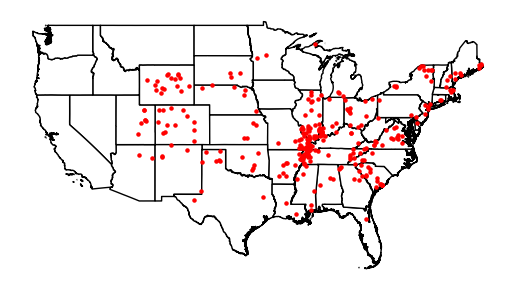

In [5]:
ax = states.plot(color='white', edgecolor='black')
quakes.plot(marker='o', color='red', markersize=5,ax=ax)
ax.set_axis_off();

Now we can easily identify a pattern of clustering in the intersection of Illinois, Missouri, Kentucky and Tennesee. That is the power of mapping!!!!!

Let us create a cool interactive map (we will cover the code in detail). We are going to create a basic choropleth map which contains all the states along with the counts and geometries. 

In [6]:
earthQuakesTotalWithStates = gpd.read_postgis("select u.name,u.geom, count(e.gid) as total_quakes from us_states u left join earth_quakes e on st_contains(u.geom,e.geom) and e.mwe>=4.0 where not u.state_abbr in('PR','VI','AK','HI','DC') group by u.name,u.geom order by total_quakes desc",conn)
earthQuakesTotalWithStates

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,name,geom,total_quakes
0,Illinois,"MULTIPOLYGON (((-90.43711 42.50713, -90.42638 ...",34
1,Missouri,"MULTIPOLYGON (((-91.72747 40.61144, -91.72006 ...",34
2,Tennessee,"MULTIPOLYGON (((-87.84959 36.66369, -87.85320 ...",23
3,Arkansas,"MULTIPOLYGON (((-94.29160 36.49930, -94.28957 ...",19
4,Wyoming,"MULTIPOLYGON (((-109.10345 45.00590, -109.0891...",17
5,Virginia,"MULTIPOLYGON (((-75.96630 36.55919, -75.96345 ...",16
6,South Carolina,"MULTIPOLYGON (((-80.90452 32.07512, -80.90340 ...",16
7,New York,"MULTIPOLYGON (((-73.83390 40.59370, -73.83156 ...",14
8,Ohio,"MULTIPOLYGON (((-83.00718 41.44634, -83.00750 ...",13
9,Colorado,"MULTIPOLYGON (((-106.37558 41.00072, -106.3524...",13


In [7]:
earthQuakesTotalWithStates.explore(
     column="total_quakes", # make choropleth based on "BoroName" column
     tooltip="total_quakes", # show "BoroName" value in tooltip (on hover)
     popup=True, # show all values in popup (on click)
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     style_kwds=dict(color="black") # use black outline
    )

### Types of maps

#### Reference Maps

Reference maps **store data and show a variety of features for a variety of uses**. These maps function like general storehouses of information. A simple way to create a reference map in Python is by using folium 

In [8]:
import folium
map = folium.Map(location=[41.504, -81.608], tiles="OpenStreetMap", zoom_start=9)
map

#### Thematic Maps

Thematic maps **highlight specific themes**. Their chief goal is to **focus the user’s attention on specific features or characteristics**. They highlight features, data, or concepts, and these data may be **qualitative, quantitative, or both**. Thematic maps can be further divided into two main categories: **qualitative and quantitative**. **Qualitative thematic maps show the spatial extent of categorical, or nominal, data (e.g., soil type, land cover, political districts)**. **Quantitative thematic maps, conversely, demonstrate the spatial patterns of numerical data (e.g., income, age, population)**.

The Earthquake spatial distribution map that we have just shown in the previous section is an example of a thematic map, with count of earthquakes as the underlying variable of interest. So is it a quantitative or a qualitative thematic map??

We will look into the details about creating thematic maps in the upcoming sections.

Based on the category of the underlying data, different types of maps can be generated.

##### Single Symbol Map

Applies the same symbol to every features in the map. Let us quickly try an example. 

We want to plot all the schools in the Harlem neighborhood in Manhattan. 

The query

```sql
select n.gid,n.schoolname,n.geom from nyc_schools n,nyc_neighborhoods ne where st_within(n.geom,ne.geom) and ne.name='Harlem' and ne.boroname = 'Manhattan'
```
Let us run that query and get the results in geopandas

In [9]:
schoolsHarlem = gpd.read_postgis("select n.gid,n.schoolname,n.geom from nyc_schools n,nyc_neighborhoods ne where st_within(n.geom,ne.geom) and ne.name='Harlem' and ne.boroname = 'Manhattan'",conn)
schoolsHarlem

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,gid,schoolname,geom
0,446,P.S. 076 A. PHILIP RANDOLPH,POINT (588453.656 4517815.819)
1,453,P.S. 092 MARY MCLEOD BETHUNE,POINT (588891.889 4518772.523)
2,465,P.S. 123 MAHALIA JACKSON,POINT (589022.430 4519328.957)
3,474,P.S. 133 FRED R MOORE,POINT (589442.041 4518165.212)
4,482,P.S. 149 SOJOURNER TRUTH,POINT (588723.469 4517368.551)
5,486,P.S. 154 HARRIET TUBMAN,POINT (588644.058 4518278.854)
6,497,P.S. 175 HENRY H GARNET,POINT (589152.615 4518683.303)
7,503,P.S. 185 JOHN M. LANGSTON,POINT (588635.244 4516897.637)
8,509,P.S. 194 COUNTEE CULLEN,POINT (589297.885 4519469.309)
9,511,P.S. 197 JOHN B. RUSSWURM,POINT (589604.639 4518576.552)


Now we can straightaway plot it

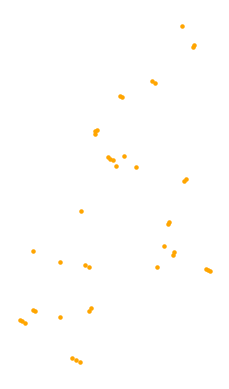

In [10]:
ax = schoolsHarlem.plot(marker='o', color='orange', markersize=5)
ax.set_axis_off()

Not that useful right. Let us add a basemap (we can use the explore method of geodataframe)

In [11]:
schoolsHarlem.explore(tooltip=True,marker_type='circle',marker_kwds={'radius':20,'fill':True},style_kwds={'fillColor':'green','color':'green','fillOpacity':.3})

As you can see we are representing all the schools with a single symbol (a green circle).

##### Categorized Symbol Map

We used categorized symbol map to **represent nominal data**. **Nominal data is data that can be labelled or classified into mutually exclusive categories within a variable.** Let's look at developing a categorized symbol map. Let us use our nyc_streets dataset to plot all the streets that pass through Harlem in Manhattan Borough based on the type of street.

In [12]:
streetsinHarlem = gpd.read_postgis("select n.gid,n.name,n.type,n.geom from nyc_streets n,nyc_neighborhoods ne where st_intersects(n.geom,ne.geom) and ne.name='Harlem' and ne.boroname='Manhattan'",conn)
streetsinHarlem

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


,gid,name,type,geom
0,895,None,residential,"MULTILINESTRING ((588366.591 4516889.461, 5883..."
1,827,Ctrl Park Powell Blvd Appr,residential,"MULTILINESTRING ((588128.323 4517017.849, 5881..."
2,709,Central Park N,residential,"MULTILINESTRING ((588643.643 4516743.660, 5886..."
3,729,Frederick Douglass Cir,residential,"MULTILINESTRING ((587902.420 4517177.034, 5879..."
4,685,Fred Douglass Cir,residential,"MULTILINESTRING ((587918.329 4517130.482, 5878..."
...,...,...,...,...
132,1804,None,motorway_link,"MULTILINESTRING ((589878.480 4518747.141, 5898..."
133,1808,None,motorway_link,"MULTILINESTRING ((589876.922 4519090.301, 5898..."
134,1877,None,motorway_link,"MULTILINESTRING ((590339.989 4517217.954, 5903..."
135,2060,None,motorway_link,"MULTILINESTRING ((590274.787 4517218.046, 5902..."


So there are 137 streets. We are going to create a categorical map based on the type of street. 

(584933.3757404934, 590597.4463504421, 4507744.033702375, 4524160.48633459)

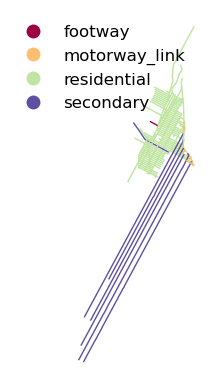

In [13]:
ax = streetsinHarlem.plot(column='type', categorical=True, cmap='Spectral', linewidth=1,
         legend=True, legend_kwds={'fontsize':12,'frameon':False,'loc':'best'})
ax.axis('off')

In [14]:
streetsinHarlem.explore(column='type',categorical=True, cmap='Spectral',tooltip=True,legend=True,tiles='CartoDB dark_matter')

##### Proportional Symbol Map

A proportional symbol map represents **quantitative variables using symbols whose sizes are proportional to the value of the variable**. That is, the map uses the visual variable size (the only one with the quantitative property) to transmit the value of the variable being represented. Let us look at an example. For this example we are going to use an interesting dataset which has the information about rail accidents in USA over time. Let us query the table first (rail_incidents)

In [15]:
rail_accidentsSmall = pd.read_sql_query('select * from rail_incidents limit 10',conn)
rail_accidentsSmall

C:\Users\jxa421\AppData\Local\Temp\ipykernel_40440\2715197038.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  rail_accidentsSmall = pd.read_sql_query('select * from rail_incidents limit 10',conn)


,id,date,fips_county
0,71001,2017-06-06,17031
1,71002,2017-06-06,17031
2,71003,1981-04-06,36067
3,71004,2007-01-11,22095
4,71005,2017-10-07,17091
5,71006,2017-10-15,17091
6,71007,2017-12-04,17197
7,71008,2016-12-19,17031
8,71009,2017-03-30,17031
9,71010,2017-04-06,17031


Unfortunately the table doesnot have any spatial information. So how to spatialize this table. We have a column called fips_county which is the fips code for counties. So we can join this table with the us_counties table. 

Now let us create a query which retrieves the centroid of all counties along with the total number of incidents.

```sql
select geoid,st_centroid(geom) as geom,count(id) as total_incidents from us_counties c left join rail_incidents r on c.geoid=r.fips_county group by geoid,geom
```

Let us call this in geopandas

In [16]:
allCounties = gpd.read_postgis(r'select geoid,c.name,st_centroid(geom) as geom,count(id) as total_incidents from us_counties c left join rail_incidents r on c.geoid=r.fips_county group by geoid,c.name,geom',conn)

E:\sbd2\lib\site-packages\geopandas\io\sql.py:154: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [17]:
allCounties.head()

,geoid,name,geom,total_incidents
0,01001,Autauga,POINT (-86.64273 32.53492),0
1,01003,Baldwin,POINT (-87.72256 30.72748),0
2,01005,Barbour,POINT (-85.39321 31.86958),0
3,01007,Bibb,POINT (-87.12648 32.99863),0
4,01009,Blount,POINT (-86.56738 33.98087),0


In [18]:
allCounties['mksize'] = allCounties['total_incidents']//200

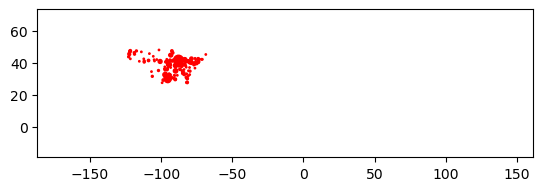

In [19]:
ax = allCounties.plot(markersize='mksize', color="red")

just for zooming in we can reduce the map view port for contiguos us states

(25.02, 49.28)

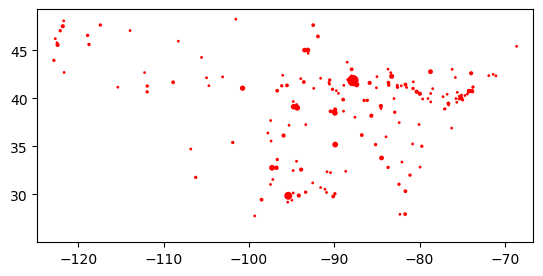

In [20]:
ax = allCounties.plot(markersize='mksize', color="red")
ax.set_xlim((-124.77,-66.67))
ax.set_ylim((25.02,49.28))

May be plot the states for reference

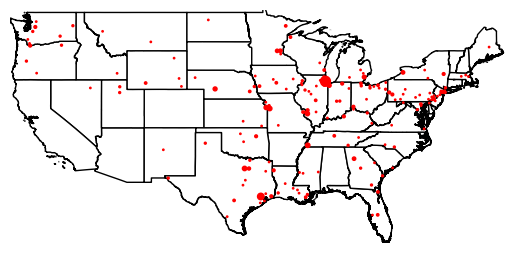

In [21]:
ax = states.plot(color='white', edgecolor='black')
ax.set_xlim((-124.77,-66.67))
ax.set_ylim((25.02,49.28))
allCounties.plot(markersize='mksize', color="red",ax=ax)
ax.set_axis_off()

In [22]:
allCounties.max()

C:\Users\jxa421\AppData\Local\Temp\ipykernel_40440\3166947593.py:1: FutureWarning: The default value of numeric_only in GeoDataFrame.max is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  allCounties.max()


geoid                78030
name               Ziebach
total_incidents      10250
mksize                  51
dtype: object

Now let us try to do that with an interactive map (a bit more involved as we need to use a style function). 

In [23]:
allCounties.explore(tiles='CartoDB positron',tooltip=True,style_kwds={'fillColor':'red','color':'red','fillOpacity':.3,'style_function':lambda x:{'radius':x["properties"]["mksize"]}})

In the next lecture we will look into choropleth mapping, which is one of the most commonly used thematic mapping method. 